In [5]:
import astropy.units as u
import datetime
import numpy as np
import pandas as pd
import glob
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import sunpy.map

In [2]:
hmi_files=sorted(glob.glob('hmi_part/data/HMI/*.fi*'))
hmi_maps=sunpy.map.Map(hmi_files)

In [32]:
hmi_files

['hmi_part/data/HMI\\hmi_v_45s_2011_01_28_00_01_30_tai_dopplergram.fits',
 'hmi_part/data/HMI\\hmi_v_45s_2011_01_29_00_01_30_tai_dopplergram.fits',
 'hmi_part/data/HMI\\hmi_v_45s_2011_01_30_00_01_30_tai_dopplergram.fits',
 'hmi_part/data/HMI\\hmi_v_45s_2011_01_31_00_01_30_tai_dopplergram.fits',
 'hmi_part/data/HMI\\hmi_v_45s_2011_02_01_00_01_30_tai_dopplergram.fits',
 'hmi_part/data/HMI\\hmi_v_45s_2011_02_02_00_01_30_tai_dopplergram.fits',
 'hmi_part/data/HMI\\hmi_v_45s_2011_02_03_00_01_30_tai_dopplergram.fits',
 'hmi_part/data/HMI\\hmi_v_45s_2011_02_04_00_01_30_tai_dopplergram.fits',
 'hmi_part/data/HMI\\hmi_v_45s_2011_02_05_00_01_30_tai_dopplergram.fits',
 'hmi_part/data/HMI\\hmi_v_45s_2011_02_06_00_01_30_tai_dopplergram.fits',
 'hmi_part/data/HMI\\hmi_v_45s_2011_02_07_00_01_30_tai_dopplergram.fits',
 'hmi_part/data/HMI\\hmi_v_45s_2011_02_08_00_01_30_tai_dopplergram.fits',
 'hmi_part/data/HMI\\hmi_v_45s_2011_02_09_00_01_30_tai_dopplergram.fits',
 'hmi_part/data/HMI\\hmi_v_45s_2011_02

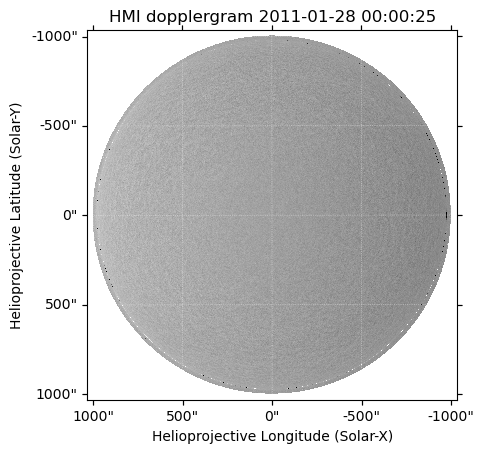

In [3]:
hmi_maps[0].plot()

In [51]:
size=100
data=sunpy.image.resample.resample(hmi_maps[0].data,(size,size))# Generate the x, y coordinates for the grid
x, y = np.meshgrid(np.arange(data.shape[1]), np.arange(data.shape[0]))

# Create a 3D scatter plot
fig = go.Figure(data=go.Scatter3d(
    x=x.flatten(),
    y=y.flatten(),
    z=data.flatten(),
    mode='markers',
    marker=dict(
        size=4,
        color=data.flatten(),
        colorscale='Viridis',
        opacity=0.8
    )
))

# Set the width and height of the figure
fig.update_layout(
    width=600,  # Specify the width in pixels
    height=600  # Specify the height in pixels
)

# Show the plot
fig.show()


In [45]:
num=100
size=100
r=size/2
x, y = np.meshgrid(np.linspace(-r,r,num), np.linspace(-r,r,num))
z=np.sqrt(r**2-x**2-y**2)

# Create a 3D scatter plot
fig = go.Figure(data=go.Scatter3d(
    x=x.flatten(),
    y=y.flatten(),
    z=z.flatten(),
    mode='markers',
    marker=dict(
        size=4,
        color=data.flatten(),
        colorscale='Viridis',
        opacity=0.8
    )
))

# Set the width and height of the figure
fig.update_layout(
    width=600,  # Specify the width in pixels
    height=400  # Specify the height in pixels
)

# Show the plot
fig.show()


C:\Users\14902\AppData\Local\Temp\ipykernel_22356\1881287323.py:5: RuntimeWarning:

invalid value encountered in sqrt



In [49]:
num=100
size=100
w=10
r=size/2
x, y = np.meshgrid(np.linspace(-r,r,num), np.linspace(-r,r,num))
# z=np.sqrt(r**2-x**2-y**2)

los_velocity=w*x
# Create a 3D scatter plot
fig = go.Figure(data=go.Scatter3d(
    x=x.flatten(),
    y=y.flatten(),
    z=los_velocity.flatten(),
    mode='markers',
    marker=dict(
        size=4,
        color=data.flatten(),
        colorscale='Viridis',
        opacity=0.8
    )
))

# Set the width and height of the figure
fig.update_layout(
    width=600,  # Specify the width in pixels
    height=600  # Specify the height in pixels
)

# Show the plot
fig.show()


In [12]:
fig.write_html('test_3d.html')

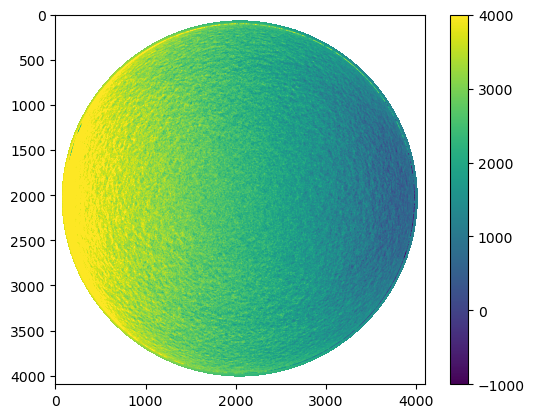

In [13]:
fig,ax=plt.subplots()
sc=ax.imshow(hmi_maps[0].data,vmin=-1000,vmax=4000)
plt.colorbar(sc)

Observatory,SDO
Instrument,HMI FRONT2
Detector,HMI
Measurement,dopplergram
Wavelength,6173.0
Observation Date,2011-01-29 00:00:25
Exposure Time,Unknown
Dimension,[4096. 4096.] pix
Coordinate System,helioprojective
Scale,[0.504222 0.504222] arcsec / pix
Reference Pixel,[2044.13501 2041.223389] pix

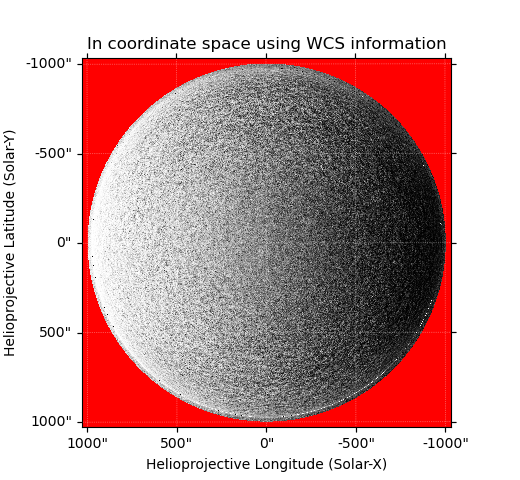
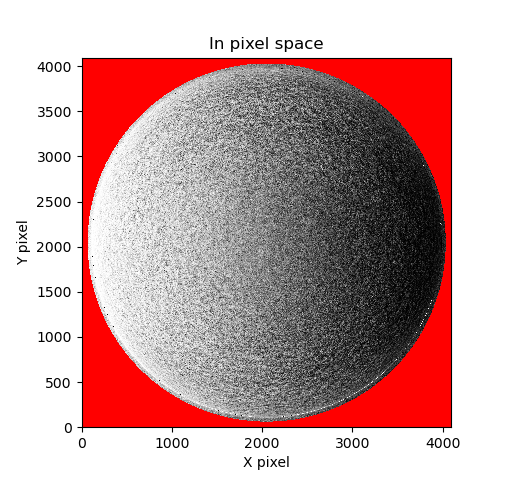
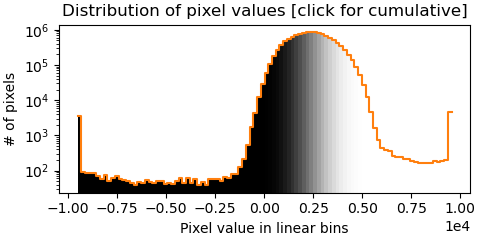
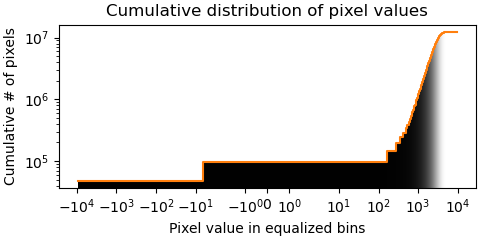

In [15]:
hmi_maps[1]

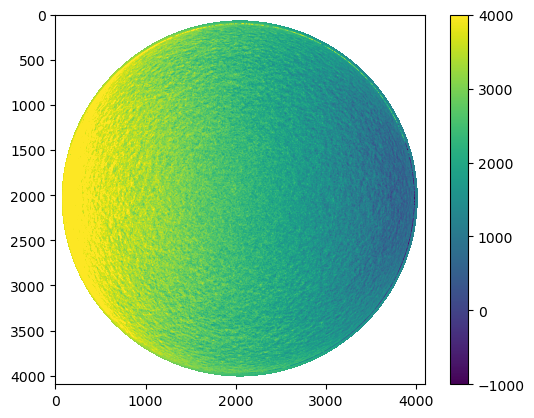

In [74]:
fig,ax=plt.subplots()
sc=ax.imshow(hmi_maps[1].data,vmin=-1000,vmax=4000)
plt.colorbar(sc)

In [44]:
np.shape(hmi_maps[0].data)

(4096, 4096)

In [46]:
ave=np.full(np.shape(hmi_maps[0].data),0)
for i in list(range(len(hmi_maps))):
    ave=ave+hmi_maps[i].data
ave=ave/len(hmi_maps)

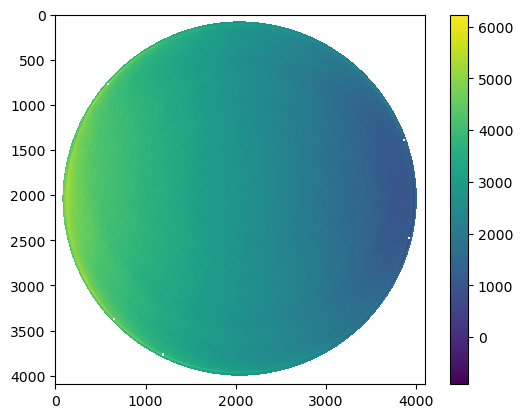

In [48]:
fig,ax=plt.subplots()
sc=ax.imshow(ave)
plt.colorbar(sc)

(array([1., 1., 1., ..., 0., 0., 1.]),
 array([-14674.27419355, -14669.01242888, -14663.75066422, ...,
          8824.76679325,   8830.02855792,   8835.29032258]),
 <BarContainer object of 4468 artists>)

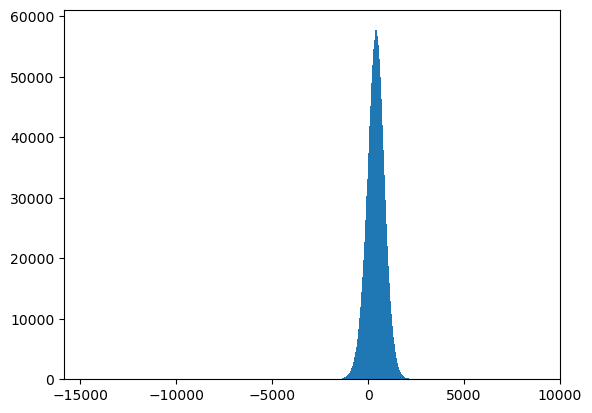

In [55]:
fig,ax=plt.subplots()
ax.hist(hmi_maps[i].data.ravel()-ave.ravel(),bins='auto',)

C:\Users\14902\AppData\Local\Temp\ipykernel_18660\902569061.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,ax=plt.subplots()


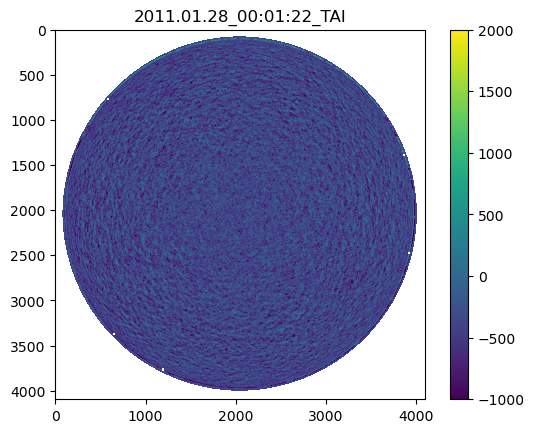

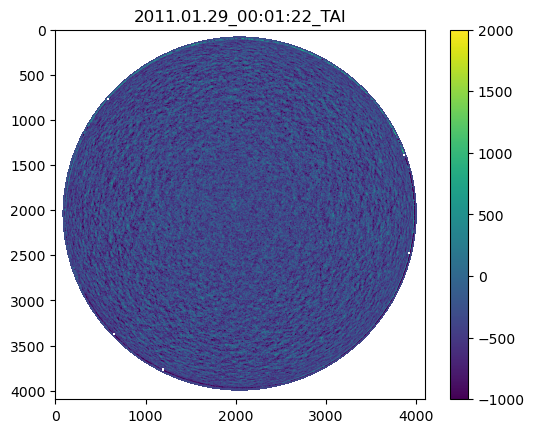

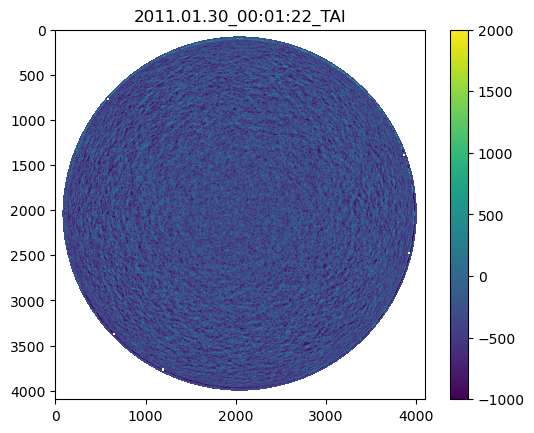

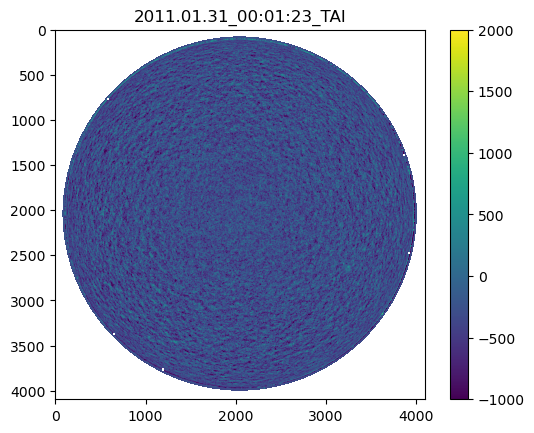

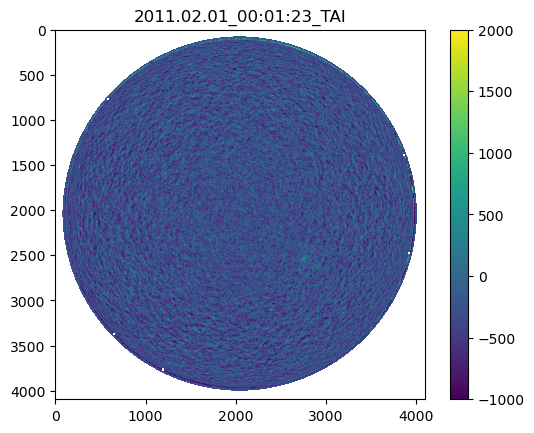

...

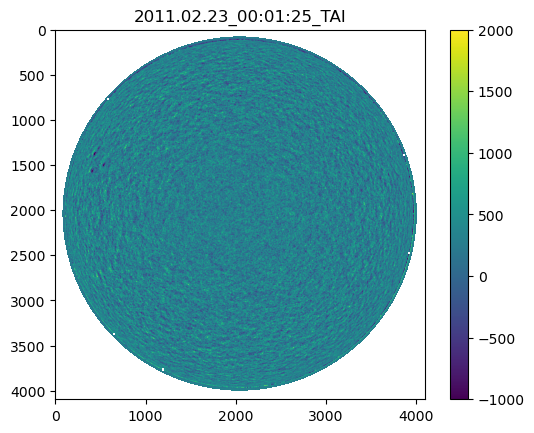

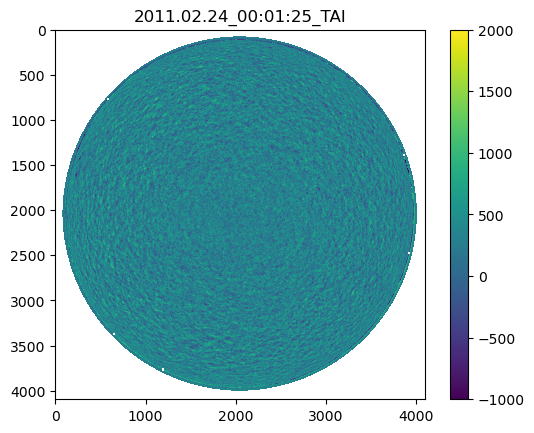

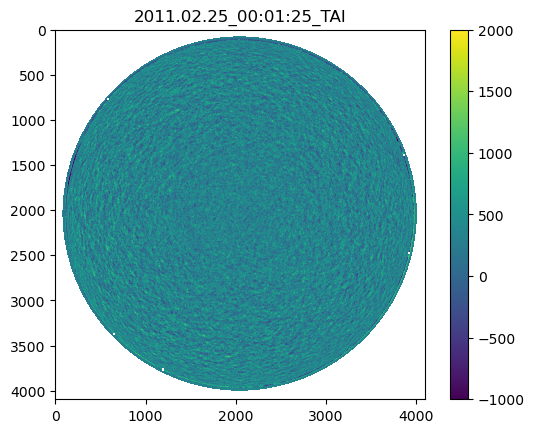

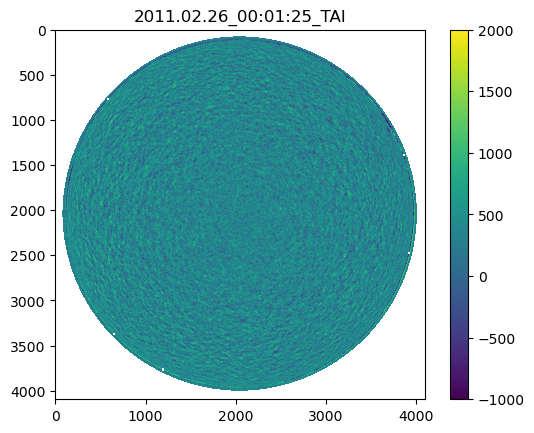

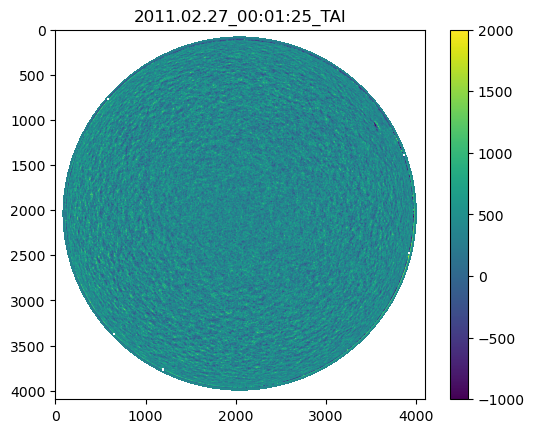

In [57]:
for i in list(range(len(hmi_maps))):
    fig,ax=plt.subplots()
    sc=ax.imshow(hmi_maps[i].data-ave,vmin=-1000,vmax=2000)
    ax.set_title(hmi_maps[i].meta['t_obs'])
    plt.colorbar(sc)

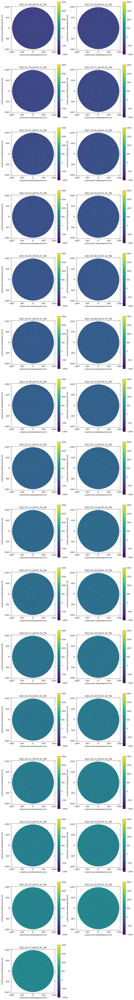

In [73]:
fig = plt.figure(figsize=(12, 100)) # Set the figure size to 10x5 inches
for i in range(len(hmi_maps)):

    ax = fig.add_subplot( int(len(hmi_maps)/2)+1,2, i+1, projection=hmi_maps[i])
    sc=ax.imshow(hmi_maps[i].data-ave,vmin=-1000,vmax=2000)
    ax.set_title(hmi_maps[i].meta['t_obs'])
    plt.colorbar(sc)
    
plt.savefig("hmi_month.png")

## AIA & HMI

In [58]:
aia_adjusted_files=sorted(glob.glob('aia_part/data/AIA/*adjusted.fits'))
aia_adjusted_maps=sunpy.map.Map(aia_adjusted_files)

In [ ]:
for i in list(range(len(hmi_maps))):
    fig,ax=plt.subplots()
    aia_adjusted_maps[i].plot()
    ax.set_title(aia_adjusted_maps.meta['t_obs'])
    plt.colorbar(sc)

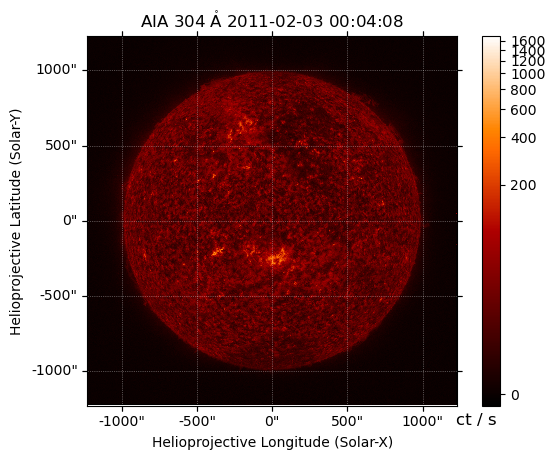

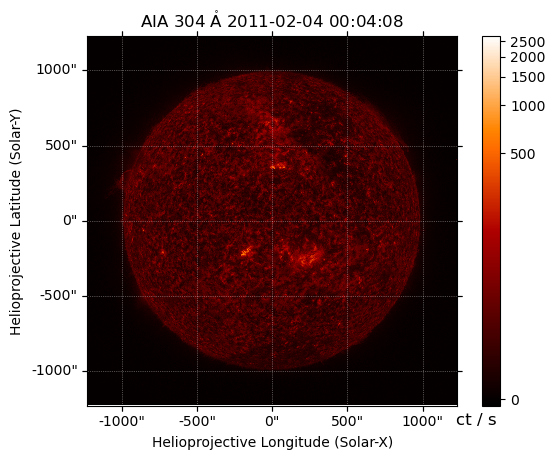

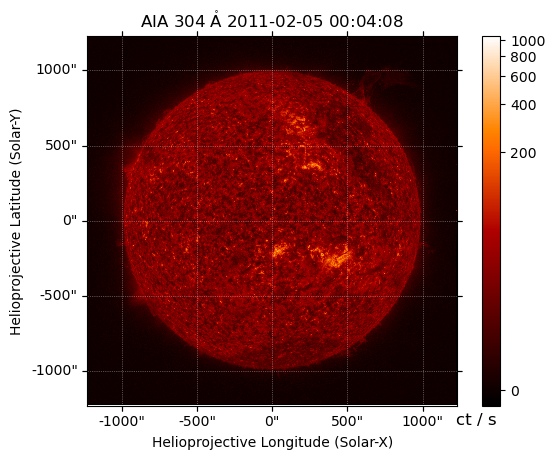

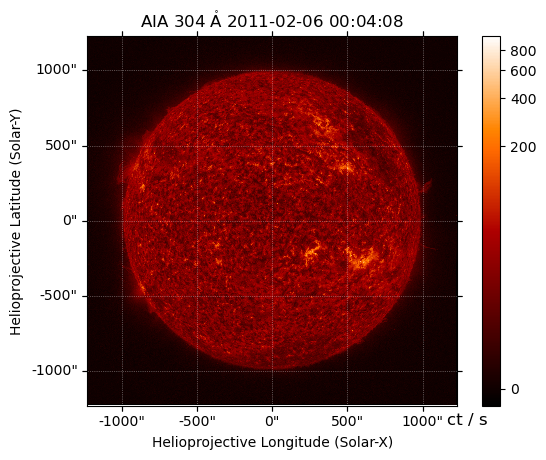

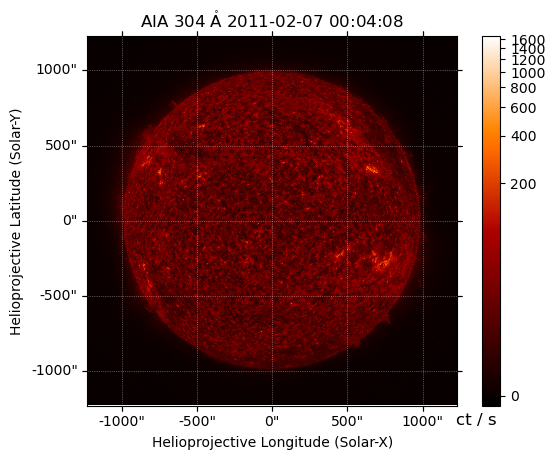

...

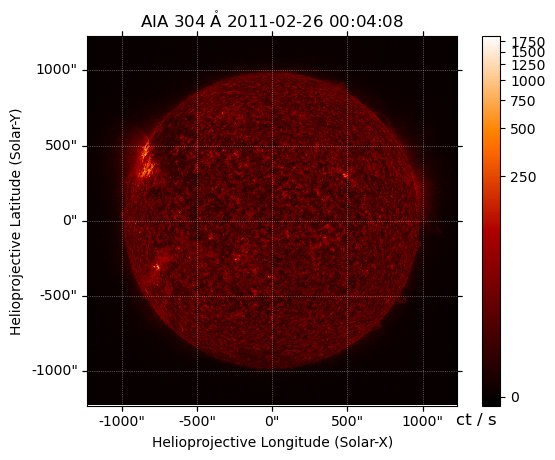

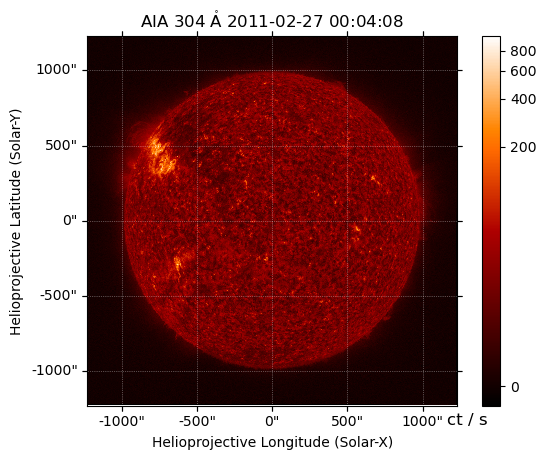

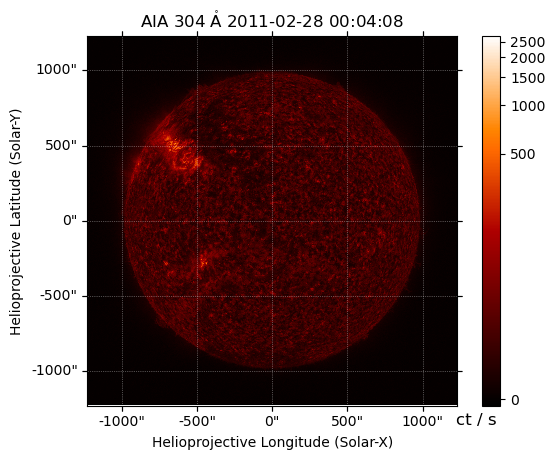

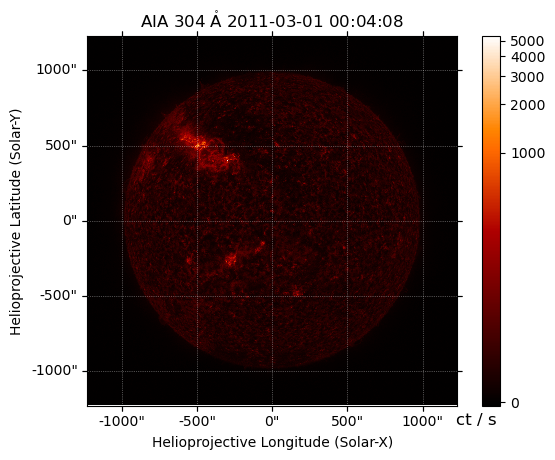

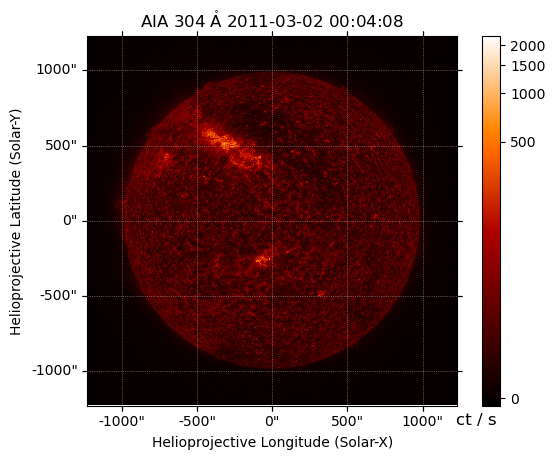